In [109]:
import cv2
import numpy as np
import math
from start_openpose import op, opWrapper
from get_pose_data import get_pose_data
from get_video_frames import get_video_frames
from get_wrist_points import get_wrist_points

import matplotlib.pyplot as plt
import matplotlib.patches as patches

In [2]:
frames, index = get_video_frames("two_hand.mp4", 10)

Opened two_hand.mp4 successfully.
Reading frame 0 of 409
Reading frame 10 of 409
Reading frame 20 of 409
Reading frame 30 of 409
Reading frame 40 of 409
Reading frame 50 of 409
Reading frame 60 of 409
Reading frame 70 of 409
Reading frame 80 of 409
Reading frame 90 of 409
Reading frame 100 of 409
Reading frame 110 of 409
Reading frame 120 of 409
Reading frame 130 of 409
Reading frame 140 of 409
Reading frame 150 of 409
Reading frame 160 of 409
Reading frame 170 of 409
Reading frame 180 of 409
Reading frame 190 of 409
Reading frame 200 of 409
Reading frame 210 of 409
Reading frame 220 of 409
Reading frame 230 of 409
Reading frame 240 of 409
Reading frame 250 of 409
Reading frame 260 of 409
Reading frame 270 of 409
Reading frame 280 of 409
Reading frame 290 of 409
Reading frame 300 of 409
Reading frame 310 of 409
Reading frame 320 of 409
Reading frame 330 of 409
Reading frame 340 of 409
Reading frame 350 of 409
Reading frame 360 of 409
Reading frame 370 of 409
Reading frame 380 of 409
Re

In [3]:
left_wrist_points = get_wrist_points(frames, "left")

7
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]
[1.5221179e+03 7.0686230e+02 6.5055591e-01]
[1.5015419e+03 4.8615991e+02 6.9646561e-01]
[1.5132517e+03 4.4202164e+02 6.7886859e-01]
[1.5045101e+03 4.3609903e+02 7.2015142e-01]
[1.5016021e+03 4.3318231e+02 7.1269095e-01]
[1.5103732e+03 4.3904672e+02 7.0864272e-01]
[1.4987030e+03 4.3906046e+02 7.2027814e-01]
[1.5016034e+03 4.5372321e+02 7.0337915e-01]
[1.4985868e+03 4.6265216e+02 7.2365141e-01]
[1.5016228e+03 4.6846536e+02 7.1229118e-01]
[1.5045199e+03 4.6553775e+02 6.9568914e-01]
[1.4868062e+03 4.8618390e+02 7.0923489e-01]
[1.4487129e+03 5.0087100e+02 7.3791575e-01]
[1.4515118e+03 4.9201495e+02 7.1840411e-01]
[1.4661555e+03 5.0388858e+02 7.1768188e-01]
[1.4750594e+03 5.0667886e+02 7.2226763e-01]
[1.5133588e+03 5.0672400e+02 7.1612030e-01]
[1.5221270e+03 5.0969910e+02 7.2282696e-01]
[1.5103718e+03 4.8015494e+02 6.9629478e-01]
[1.4986427e+03 4.5975201e+02 6.7651540e-01]
[1.3631906e+03 7.6273761e+02 5.4977006e-01]
[1.2896083e+03 8.3051691e+02 6.8280834e-0

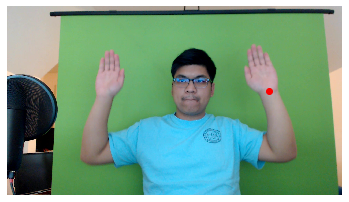

In [8]:
plt.imshow(cv2.cvtColor(frames[4], cv2.COLOR_BGR2RGB))
plt.plot(left_wrist_points[4][0], left_wrist_points[4][1], 'ro')
plt.axis("off")
plt.show()

In [25]:
def getGradientsXY(points):
    gradient_x = []
    gradient_y = []
    
    for i in range(len(points) - 1):
        dx = points[i + 1][0] - points[i][0]
        dy = points[i + 1][1] - points[i][1]
        gradient_x.append(dx)
        gradient_y.append(dy)
    
    return gradient_x, gradient_y

In [26]:
gradient_x, gradient_y = getGradientsXY(left_wrist_points)

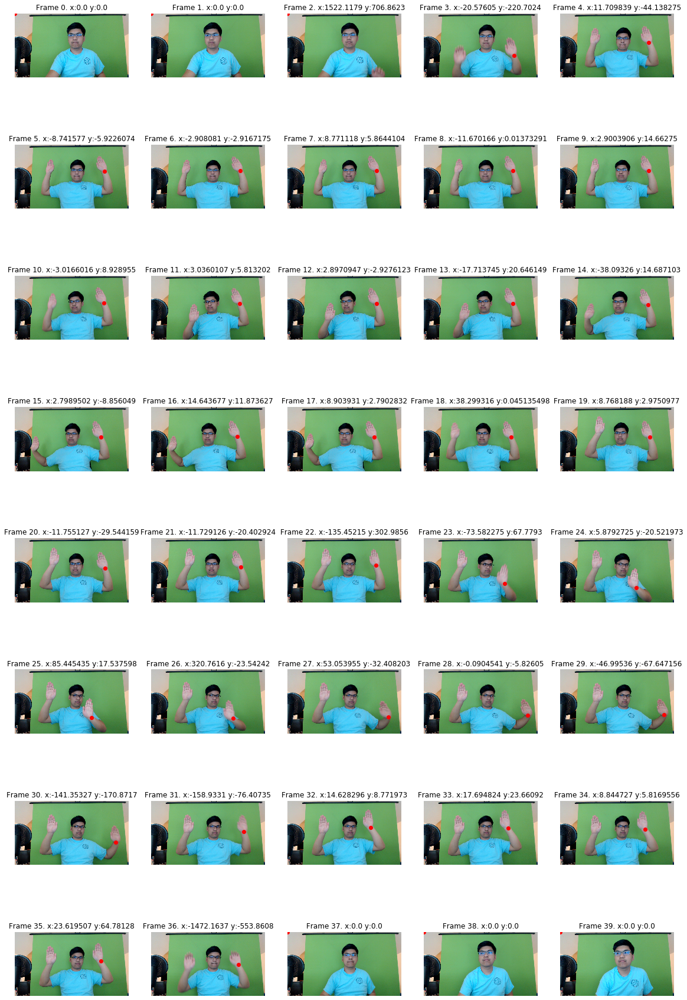

In [22]:
i1 = 0
i2 = 40
fig, plots = plt.subplots(math.ceil((i2 - i1) / 5), 5, figsize=(20, 32))
i = i1
for y in range(math.ceil((i2 - i1) / 5)):
    for x in range(5):
        plots[y][x].imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
        plots[y][x].plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
        plots[y][x].axis("off")
        plots[y][x].set_title("Frame " + str(i) + ". x:" + str(gradient_x[i]) + " y:" + str(gradient_y[i]))
        if i == i2:
            break
        else:
            i += 1
    if i == i2:
        break

In [45]:
def getAngleAndDistance(gradient_x, gradient_y):
    angles = []
    distances = []
    for i in range(len(gradient_x)):
        angle = int(math.atan2(gradient_y[i], gradient_x[i]) * 180 / math.pi)
        distance = math.sqrt(gradient_x[i] ** 2 + gradient_y[i] ** 2)
        angles.append(angle)
        distances.append(distance)
    return angles, distances

In [46]:
angles, distances = getAngleAndDistance(gradient_x, gradient_y)

In [47]:
print(distances)

[0.0, 0.0, 1678.242318598664, 221.65946836369022, 45.66516899347089, 10.558998518596995, 4.118759105160198, 10.55101052943067, 11.670174095748102, 14.946856207899835, 9.42476120514741, 6.558252633651643, 4.118746370102667, 27.20368029258348, 40.826554971983995, 9.287826372070676, 18.852593461155553, 9.330898221718742, 38.29934300218783, 9.25917573138925, 31.79686048799378, 23.534053772097554, 331.88485310407293, 100.04191289920021, 21.347533964695096, 87.226656593395, 321.6243887165427, 62.1692349898482, 5.8267519486579085, 82.36930052520336, 221.76087712197423, 176.3457256046683, 17.056803486416822, 29.54565790471237, 10.586130550250065, 68.95284917006727, 1572.9042281632842, 0.0, 0.0, 0.0, 0.0]


Finished row 0
Finished row 1
Finished row 2


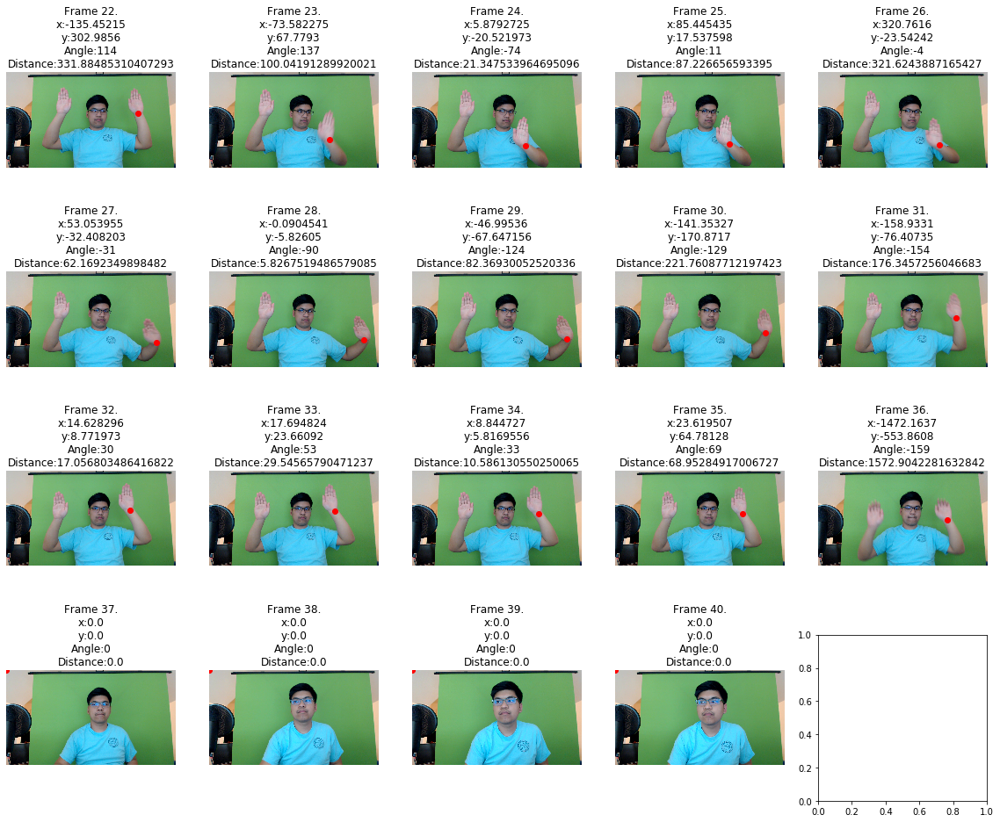

In [53]:
i1 = 22
i2 = 40
fig, plots = plt.subplots(math.ceil((i2 - i1) / 5), 5, figsize=(20, 16))
i = i1
for y in range(math.ceil((i2 - i1) / 5)):
    for x in range(5):
        plots[y][x].imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
        plots[y][x].plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
        plots[y][x].axis("off")
        plots[y][x].set_title("Frame " + str(i) + ".\nx:" + str(gradient_x[i]) + "\ny:" + str(gradient_y[i]) + "\nAngle:" + str(angles[i]) + "\nDistance:" + str(distances[i]))
        if i == i2:
            break
        else:
            i += 1
    if i == i2:
        break
    print("Finished row " + str(y))
plt.show()

## 3/4 time signature?

In [54]:
frames, index = get_video_frames("3-4_test_conduct.mp4", 5)

Opened 3-4_test_conduct.mp4 successfully.
Reading frame 0 of 535
Reading frame 5 of 535
Reading frame 10 of 535
Reading frame 15 of 535
Reading frame 20 of 535
Reading frame 25 of 535
Reading frame 30 of 535
Reading frame 35 of 535
Reading frame 40 of 535
Reading frame 45 of 535
Reading frame 50 of 535
Reading frame 55 of 535
Reading frame 60 of 535
Reading frame 65 of 535
Reading frame 70 of 535
Reading frame 75 of 535
Reading frame 80 of 535
Reading frame 85 of 535
Reading frame 90 of 535
Reading frame 95 of 535
Reading frame 100 of 535
Reading frame 105 of 535
Reading frame 110 of 535
Reading frame 115 of 535
Reading frame 120 of 535
Reading frame 125 of 535
Reading frame 130 of 535
Reading frame 135 of 535
Reading frame 140 of 535
Reading frame 145 of 535
Reading frame 150 of 535
Reading frame 155 of 535
Reading frame 160 of 535
Reading frame 165 of 535
Reading frame 170 of 535
Reading frame 175 of 535
Reading frame 180 of 535
Reading frame 185 of 535
Reading frame 190 of 535
Readi

In [64]:
left_wrist_points = get_wrist_points(frames, "left")
right_wrist_points = get_wrist_points(frames, "right")

7
[0. 0. 0.]
[0. 0. 0.]
[1.4838677e+03 9.0704517e+02 1.1988044e-01]
[1.5515969e+03 7.1565784e+02 6.4841861e-01]
[1.5397607e+03 6.4206226e+02 6.5879524e-01]
[1.5133212e+03 6.2439606e+02 7.2818637e-01]
[1.4897993e+03 6.2148401e+02 6.8970215e-01]
[1.4897059e+03 6.2161664e+02 6.7343384e-01]
[1.4897014e+03 6.5103833e+02 6.6407382e-01]
[1.4691918e+03 7.4227295e+02 6.5109456e-01]
[1.354371e+03 7.597905e+02 5.955285e-01]
[1.2660573e+03 5.1555615e+02 6.1126250e-01]
[1.2367441e+03 3.6243768e+02 7.3426390e-01]
[1.2543802e+03 3.6548123e+02 7.0133507e-01]
[1.2778329e+03 4.3909375e+02 6.3819784e-01]
[1.3044590e+03 6.6569977e+02 6.1769909e-01]
[1.2101611e+03 9.0415900e+02 2.9383889e-01]
[1.166052e+03 8.805319e+02 6.999598e-01]
[1.1659445e+03 8.1573706e+02 7.5914979e-01]
[1.1836438e+03 8.5109723e+02 6.6919738e-01]
[1.2749470e+03 9.2465955e+02 3.1334785e-01]
[1.51628723e+03 8.80512146e+02 1.23490274e-01]
[1.6192518e+03 7.6865350e+02 7.1691501e-01]
[1.6134042e+03 7.9218781e+02 7.2444576e-01]
[1.5633815e

[3.6253027e+02 7.1267969e+02 5.1595950e-01]
[4.5958594e+02 8.5110193e+02 5.9166789e-01]
[6.3914929e+02 7.8337067e+02 4.0549308e-01]
[7.8636279e+02 4.7731662e+02 6.4487213e-01]
[8.158243e+02 3.507848e+02 6.698461e-01]
[8.1294025e+02 3.5073578e+02 6.8352365e-01]
[8.1282068e+02 3.7431955e+02 6.5807325e-01]
[7.8937213e+02 4.5963315e+02 6.5965122e-01]
[7.3913617e+02 7.2155786e+02 6.5806842e-01]
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]
[0. 0. 0.]


In [67]:
gradient_x, gradient_y = getGradientsXY(left_wrist_points)
angles, distances = getAngleAndDistance(gradient_x, gradient_y)

Finished row 0
Finished row 1
Finished row 2
Finished row 3
Finished row 4
Finished row 5
Finished row 6
Finished row 7
Finished row 8


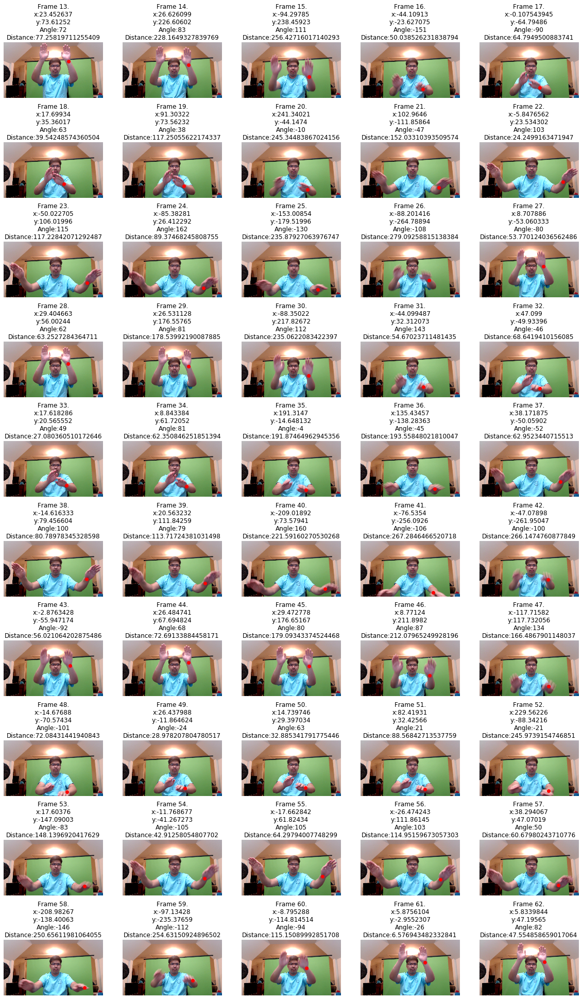

In [71]:
i1 = 13
i2 = 63
fig, plots = plt.subplots(math.ceil((i2 - i1) / 5), 5, figsize=(20, 35))
i = i1
for y in range(math.ceil((i2 - i1) / 5)):
    for x in range(5):
        plots[y][x].imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
        plots[y][x].plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
        plots[y][x].axis("off")
        plots[y][x].set_title("Frame " + str(i) + ".\nx:" + str(gradient_x[i]) + "\ny:" + str(gradient_y[i]) + "\nAngle:" + str(angles[i]) + "\nDistance:" + str(distances[i]))
        if i == i2:
            break
        else:
            i += 1
    if i == i2:
        break
    print("Finished row " + str(y))
plt.show()

#### Estimate a bounding box

In [96]:
points = np.array(left_wrist_points)

In [134]:
xy_max = np.amax(points, axis=0).astype(int)
xy_min = np.amin(points[np.sum(points, axis=1) > 0], axis=0).astype(int)
print(xy_max)
print(xy_min)

[1678 1004    0]
[1165  362    0]


Finished row 0
Finished row 1
Finished row 2
Finished row 3
Finished row 4
Finished row 5
Finished row 6
Finished row 7
Finished row 8


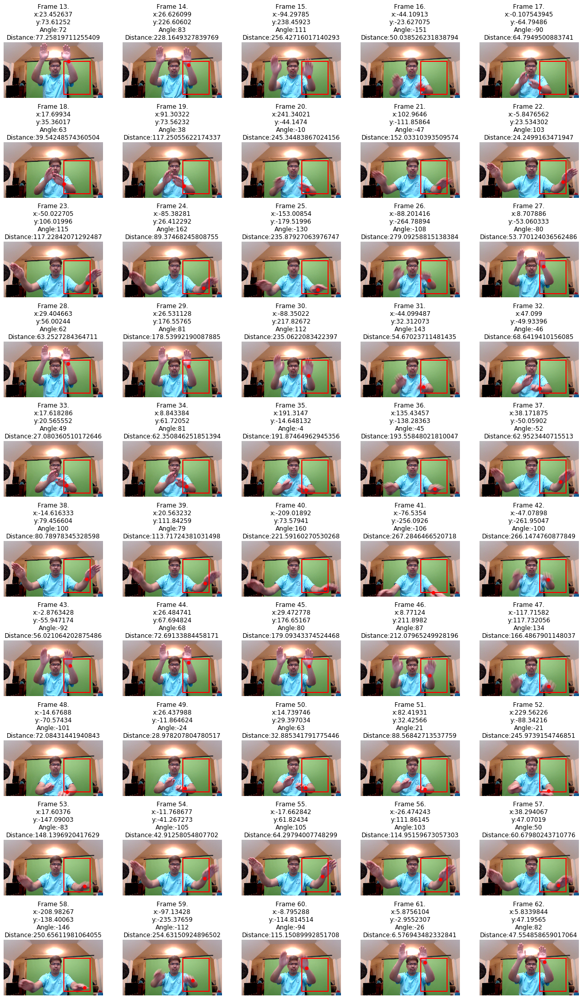

In [111]:
i1 = 13
i2 = 63
fig, plots = plt.subplots(math.ceil((i2 - i1) / 5), 5, figsize=(20, 35))
i = i1
for y in range(math.ceil((i2 - i1) / 5)):
    for x in range(5):
        plots[y][x].imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
        plots[y][x].plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
        plots[y][x].axis("off")
        plots[y][x].set_title("Frame " + str(i) + ".\nx:" + str(gradient_x[i]) + "\ny:" + str(gradient_y[i]) + "\nAngle:" + str(angles[i]) + "\nDistance:" + str(distances[i]))
        rect = patches.Rectangle(xy_min[0:2], xy_max[0] - xy_min[0], xy_max[1] - xy_min[1], linewidth=2, edgecolor='r', facecolor='none')
        plots[y][x].add_patch(rect)
        if i == i2:
            break
        else:
            i += 1
    if i == i2:
        break
    print("Finished row " + str(y))
plt.show()

## Idea? Assume the points closest to the four corners are the end of the motion

In [143]:
top_left = np.array(xy_min)
top_right = np.array([xy_max[0], xy_min[1], 0])
bottom_left = np.array([xy_min[0], xy_max[1], 0])
bottom_right = np.array(xy_max)
print(top_left, top_right, bottom_left, bottom_right)

[1165  362    0] [1678  362    0] [1165 1004    0] [1678 1004    0]


In [149]:
# Find the frames with the shortest distance to each corner.
# The first beat is close to the bottom_left...
diff_bl = np.add(np.array(left_wrist_points), bottom_left * -1)

In [158]:
dist_bl = np.array(diff_bl[:, 0] ** 2 + diff_bl[:, 1] ** 2) ** (1/2)

Finished row 0
Finished row 1
Finished row 2
Finished row 3
Finished row 4
Finished row 5
Finished row 6
Finished row 7
Finished row 8


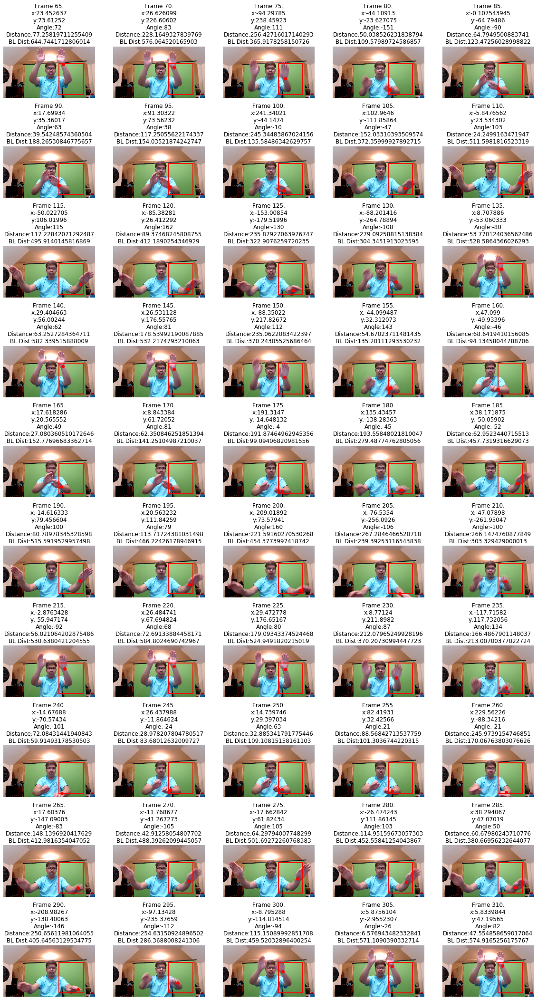

In [163]:
i1 = 13
i2 = 63
fig, plots = plt.subplots(math.ceil((i2 - i1) / 5), 5, figsize=(20, 38))
i = i1
for y in range(math.ceil((i2 - i1) / 5)):
    for x in range(5):
        plots[y][x].imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
        plots[y][x].plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
        plots[y][x].axis("off")
        plots[y][x].set_title("Frame " + str(index[i]) + ".\nx:" + str(gradient_x[i]) + "\ny:" + str(gradient_y[i]) + "\nAngle:" + str(angles[i]) + "\nDistance:" + str(distances[i]) + "\nBL Dist:" + str(dist_bl[i]))
        rect = patches.Rectangle(xy_min[0:2], xy_max[0] - xy_min[0], xy_max[1] - xy_min[1], linewidth=2, edgecolor='r', facecolor='none')
        plots[y][x].add_patch(rect)
        if i == i2:
            break
        else:
            i += 1
    if i == i2:
        break
    print("Finished row " + str(y))
plt.show()

In [170]:
# Index of frame with the minimum distance
np.where(dist_bl==np.amin(dist_bl))[0].item()

48

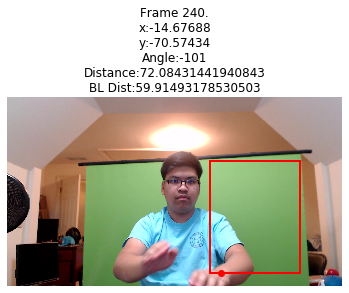

In [185]:
i = 48
fig, plot = plt.subplots()
plot.imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
plot.plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
plot.axis("off")
plot.set_title("Frame " + str(index[i]) + ".\nx:" + str(gradient_x[i]) + "\ny:" + str(gradient_y[i]) + "\nAngle:" + str(angles[i]) + "\nDistance:" + str(distances[i]) + "\nBL Dist:" + str(dist_bl[i]))
rect = patches.Rectangle(xy_min[0:2], xy_max[0] - xy_min[0], xy_max[1] - xy_min[1], linewidth=2, edgecolor='r', facecolor='none')
plot.add_patch(rect)
plt.show()

In [175]:
# Dimensions of bounding box?
width, height = xy_max[0] - xy_min[0], xy_max[1] - xy_min[1]

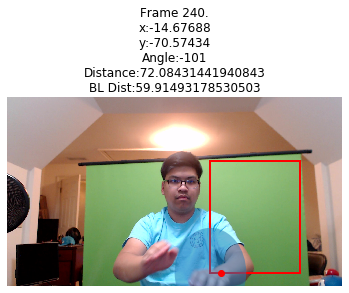

In [195]:
i = 48
fig, plot = plt.subplots()
plot.imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
plot.plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
plot.axis("off")
plot.set_title("Frame " + str(index[i]) + ".\nx:" + str(gradient_x[i]) + "\ny:" + str(gradient_y[i]) + "\nAngle:" + str(angles[i]) + "\nDistance:" + str(distances[i]) + "\nBL Dist:" + str(dist_bl[i]))
rect = patches.Rectangle(xy_min[0:2], xy_max[0] - xy_min[0], xy_max[1] - xy_min[1], linewidth=2, edgecolor='r', facecolor='none')
plot.add_patch(rect)
ellipse = patches.Ellipse(bottom_left[0:2], width=width*0.8, height=height*0.8, edgecolor='none', alpha=0.5)
plot.add_patch(ellipse)
plt.show()

In [214]:
def nearCorner(coord, corner: str, xy_min, xy_max, threshold=0.8):
    width, height = xy_max[0] - xy_min[0], xy_max[1] - xy_min[1]
    top_left = np.array(xy_min)
    top_right = np.array([xy_max[0], xy_min[1], 0])
    bottom_left = np.array([xy_min[0], xy_max[1], 0])
    bottom_right = np.array(xy_max)
    corner_coord = None
    if corner == "bl": corner_coord = bottom_left
    elif corner == "br": corner_coord = bottom_right
    elif corner == "tl": corner_coord = top_left
    elif corner == "tr": corner_coord = top_right
    
    a = (width * threshold) / 2
    b = (height * threshold) / 2
    x = coord[0]
    y = coord[1]
    h = corner_coord[0] # centerpoint
    k = corner_coord[1]
    inside = ((x - h) ** 2) / (a ** 2) + ((y - k) ** 2) / (b ** 2) < 1
    return inside

In [222]:
# Just a helper function
def plotRegionDetection(i1, i2, corner_code, corner_point, corner_threshold):
    fig, plots = plt.subplots(math.ceil((i2 - i1) / 5), 5, figsize=(20, 38))
    i = i1
    for y in range(math.ceil((i2 - i1) / 5)):
        for x in range(5):
            plots[y][x].imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
            plots[y][x].plot(left_wrist_points[i][0], left_wrist_points[i][1], 'ro')
            plots[y][x].axis("off")
            inside = nearCorner(left_wrist_points[i][0:2], corner_code, xy_min, xy_max, corner_threshold)
            plots[y][x].set_title("Frame " + str(index[i]) + ".\nx:" + str(gradient_x[i]) + "\ny:" + str(gradient_y[i]) + "\nAngle:" + str(angles[i]) + "\nDistance:" + str(distances[i]) + "\nInside BL:" + str(inside))
            rect = patches.Rectangle(xy_min[0:2], xy_max[0] - xy_min[0], xy_max[1] - xy_min[1], linewidth=2, edgecolor='r', facecolor='none')
            plots[y][x].add_patch(rect)
            ellipse = patches.Ellipse(corner_point[0:2], width=width*0.8, height=height*0.8, edgecolor='none', alpha=0.5)
            plots[y][x].add_patch(ellipse)
            if i == i2:
                break
            else:
                i += 1
        if i == i2:
            break
    plt.show()

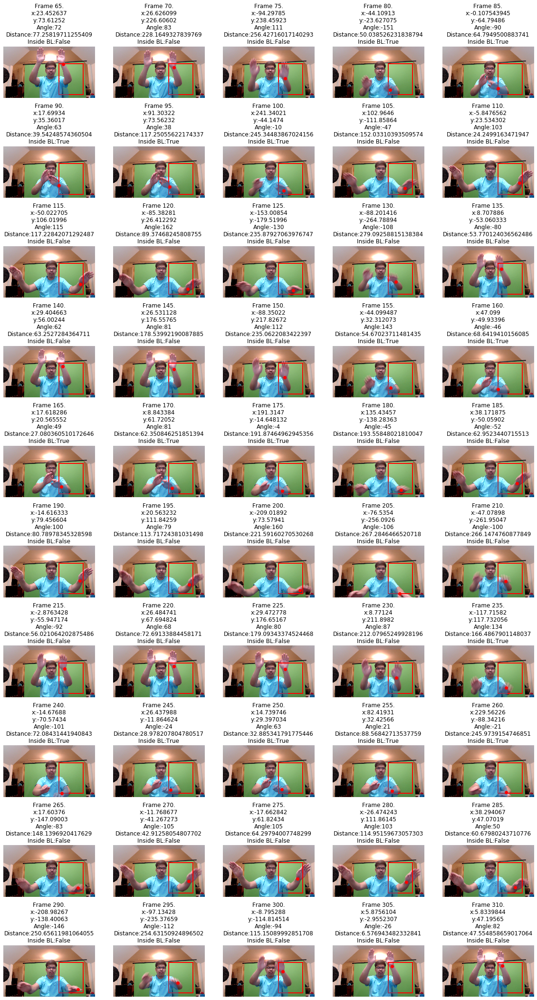

In [223]:
plotRegionDetection(13, 63, "bl", bottom_left, 0.9)

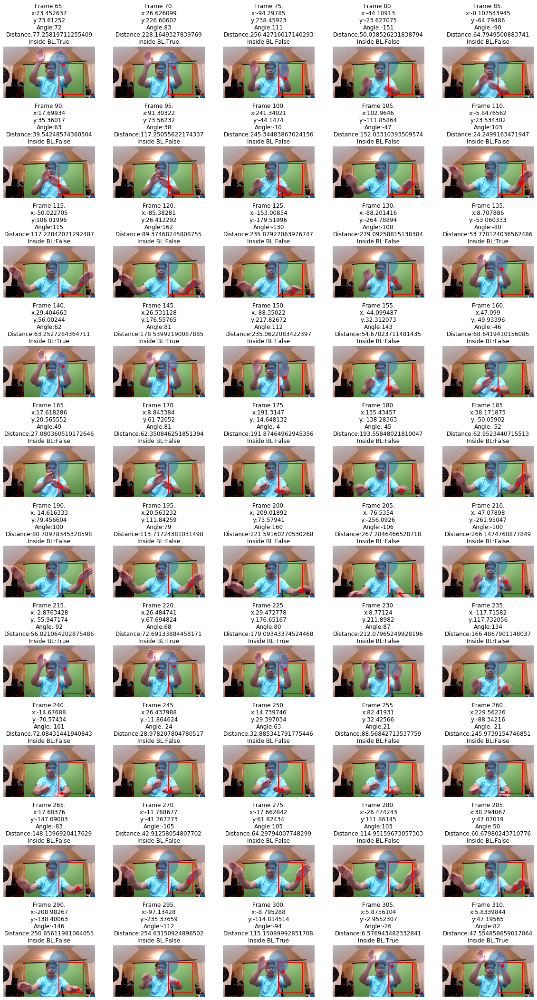

In [224]:
plotRegionDetection(13, 63, "tl", top_left, 0.9)

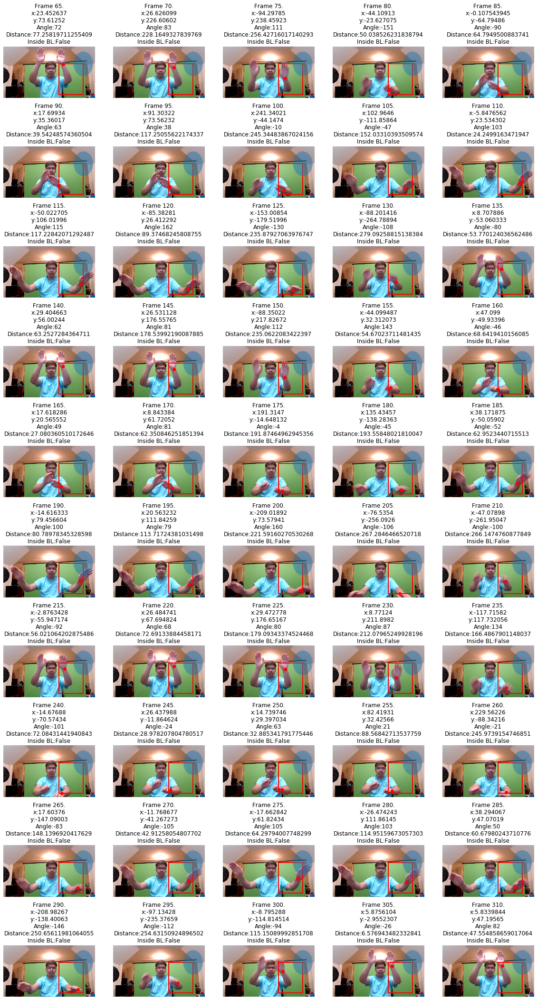

In [225]:
plotRegionDetection(13, 63, "tr", top_right, 0.9)

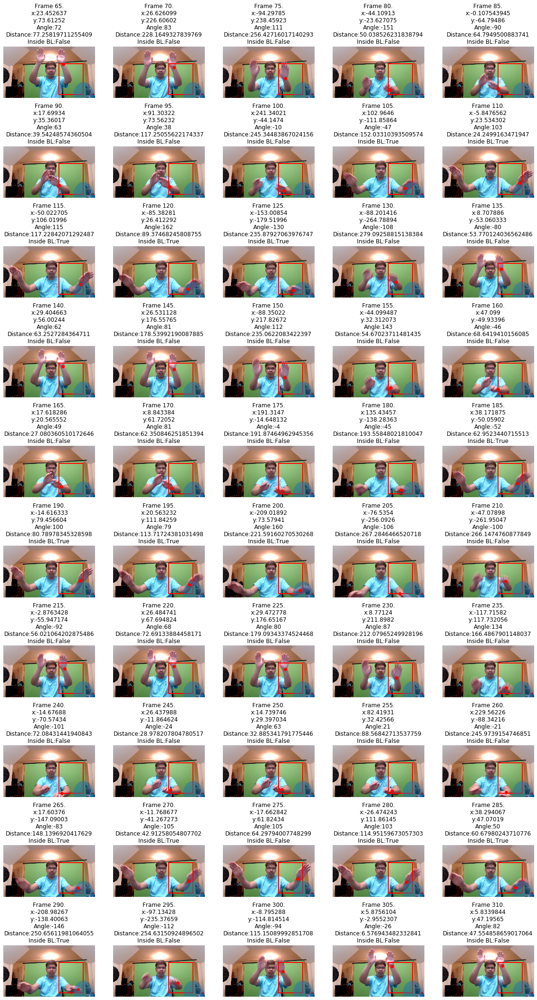

In [226]:
plotRegionDetection(13, 63, "br", bottom_right, 0.9)